<a href="https://colab.research.google.com/github/tpalczew/presentation-support/blob/main/presentation_support.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
def check_gpu():
  '''
  A simple function to check GPU existence and type
  You can simple do nvidia-smi
  '''
  import locale
  locale.getpreferredencoding = lambda: "UTF-8"
  gpu_info = !nvidia-smi
  gpu_info = '\n'.join(gpu_info)
  if gpu_info.find('failed') >= 0:
    print('Not connected to a GPU')
  else:
    print(gpu_info)

In [2]:
check_gpu()

Wed May 24 03:26:05 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    45W / 400W |      0MiB / 40960MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
# Install requirements 

In [5]:
!pip3 install -r /content/drive/MyDrive/Data/requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-gswflf34
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-gswflf34
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 934.9/934.9 kB 51.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.9/19.9 MB 80.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 83.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 90.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 86.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 219.1/219.1 kB 29.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━

In [6]:
import diffusers
print( diffusers.__version__)

0.16.1


In [7]:
import os
from diffusers.utils import load_image
from PIL import Image
import cv2
import numpy as np
from diffusers.utils import load_image
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, UniPCMultistepScheduler
import torch
from segment_anything import sam_model_registry
from segment_anything import SamAutomaticMaskGenerator
import supervision as sv
import matplotlib.pyplot as plt
from diffusers import StableDiffusionInstructPix2PixPipeline, EulerAncestralDiscreteScheduler
import gradio as gr
from clip_interrogator import Config, Interrogator
from diffusers import StableDiffusionInpaintPipeline
from diffusers import DiffusionPipeline

In [8]:
image_path = "/content/drive/MyDrive/Data/car-roundabout/00000.jpg"

In [9]:
image = load_image(image_path)

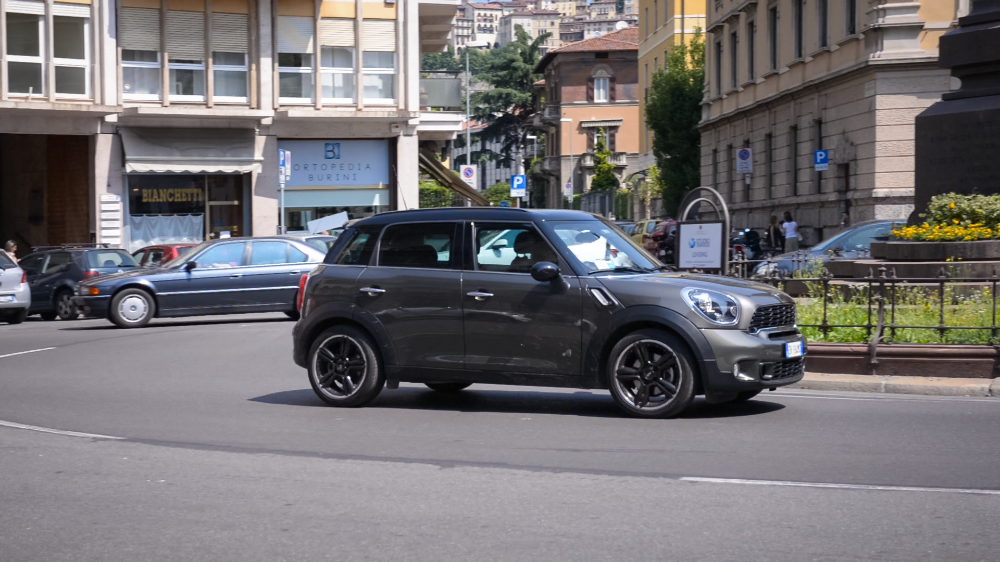

In [13]:
image

In [14]:
image.size

(1920, 1080)

In [15]:
image_np = np.array(image)

In [16]:
low_threshold = 100
high_threshold = 200
canny_image_np = cv2.Canny(image_np, low_threshold, high_threshold)

In [17]:
canny_image_np

array([[  0,   0, 255, ...,   0,   0,   0],
       [  0,   0, 255, ...,   0,   0,   0],
       [  0,   0, 255, ...,   0,   0,   0],
       ...,
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0]], dtype=uint8)

In [18]:
image_cn = canny_image_np[:, :, None]
image_cn = np.concatenate([image_cn, image_cn, image_cn], axis=2)
image_cn = Image.fromarray(image_cn)

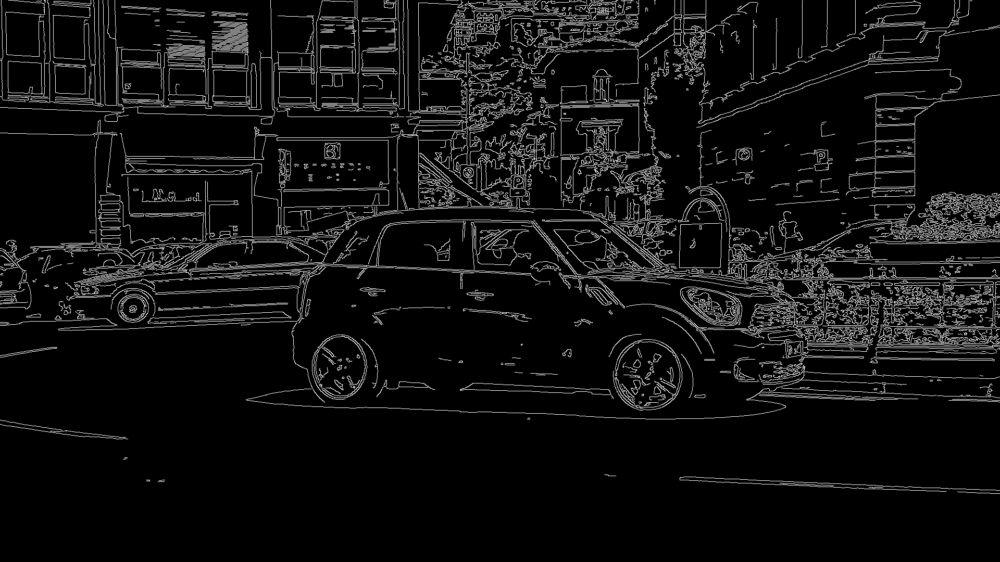

In [19]:
image_cn

In [20]:
image_cn.size

(1920, 1080)

In [11]:
controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-canny", torch_dtype=torch.float16)
CN_pipe = StableDiffusionControlNetPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", controlnet=controlnet, safety_checker=None, torch_dtype=torch.float16)
CN_pipe.scheduler = UniPCMultistepScheduler.from_config(CN_pipe.scheduler.config)

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [12]:
CN_pipe.to('cuda')

StableDiffusionControlNetPipeline {
  "_class_name": "StableDiffusionControlNetPipeline",
  "_diffusers_version": "0.16.1",
  "controlnet": [
    "diffusers",
    "ControlNetModel"
  ],
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "UniPCMultistepScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [23]:
CN_generator = torch.manual_seed(0)

In [24]:
prompt = "a blue car"

In [25]:
image_controlNet = CN_pipe(prompt, num_inference_steps=40, generator=CN_generator, image=image_cn).images[0]

  0%|          | 0/40 [00:00<?, ?it/s]

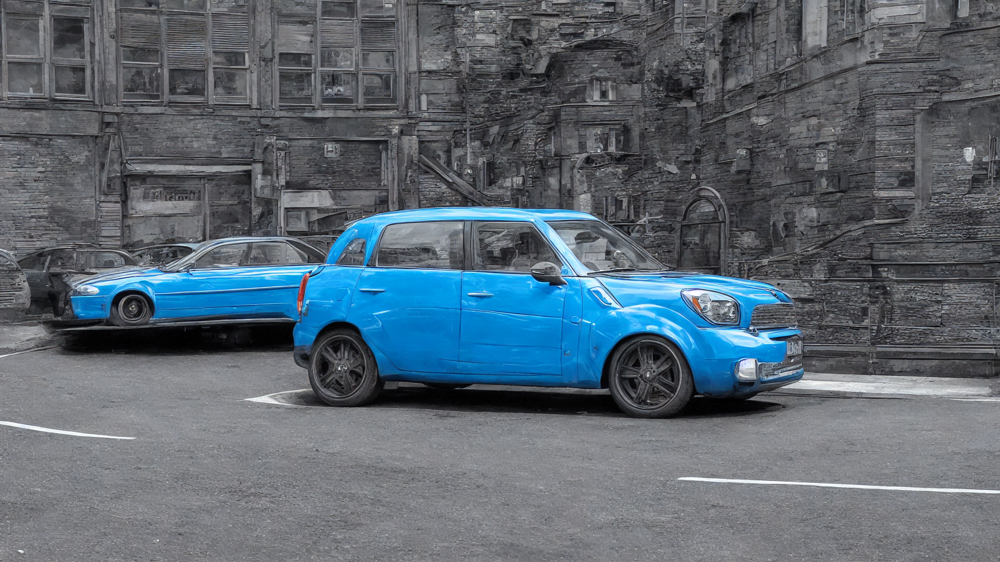

In [26]:
image_controlNet

In [27]:
# Instruct pix2pix

In [28]:
model_id = "timbrooks/instruct-pix2pix"
IP2P_pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(model_id, torch_dtype=torch.float16, safety_checker=None)
IP2P_pipe.to("cuda")

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

StableDiffusionInstructPix2PixPipeline {
  "_class_name": "StableDiffusionInstructPix2PixPipeline",
  "_diffusers_version": "0.16.1",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "requires_safety_checker": false,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "EulerAncestralDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [29]:
InstructPix2piximages = IP2P_pipe("change car color to blue", image=image,).images

  0%|          | 0/100 [00:00<?, ?it/s]

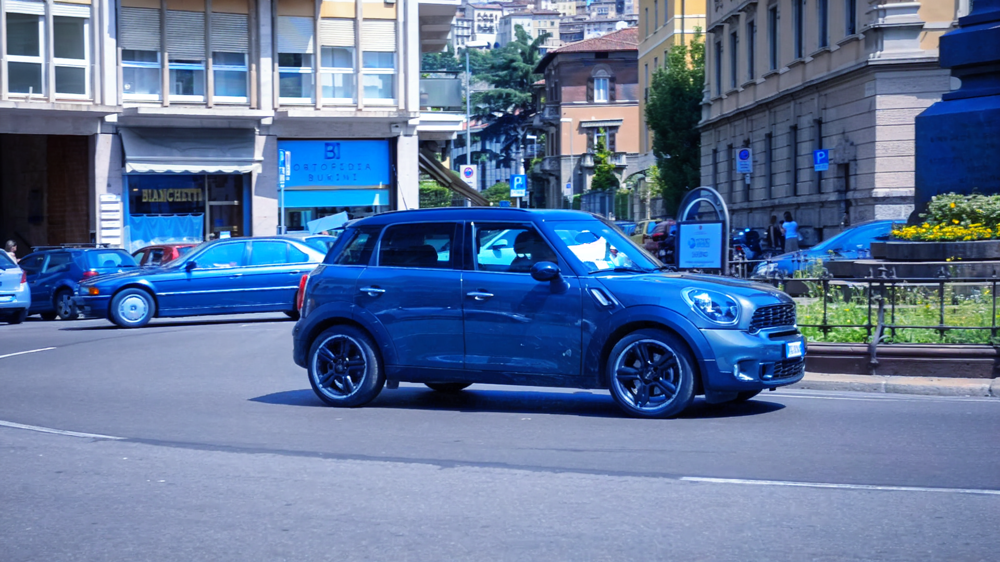

In [30]:
InstructPix2piximages[0]

In [31]:
# CLIP-Interogator

In [32]:
def set_clip_interogtor():
  caption_model_name = 'blip-large' 
  clip_model_name = 'ViT-L-14/openai'
  config = Config()
  config.clip_model_name = clip_model_name
  config.caption_model_name = caption_model_name
  ci = Interrogator(config)
  return ci 

def image_to_prompt(image, mode):
    ci.config.chunk_size = 2048 if ci.config.clip_model_name == "ViT-L-14/openai" else 1024
    ci.config.flavor_intermediate_count = 2048 if ci.config.clip_model_name == "ViT-L-14/openai" else 1024
    image = image.convert('RGB')
    if mode == 'best':
        return ci.interrogate(image)
    elif mode == 'classic':
        return ci.interrogate_classic(image)
    elif mode == 'fast':
        return ci.interrogate_fast(image)
    elif mode == 'negative':
        return ci.interrogate_negative(image)

In [33]:
ci = set_clip_interogtor()

Loading caption model blip-large...


Loading CLIP model ViT-L-14/openai...


100%|████████████████████████████████████████| 933M/933M [00:04<00:00, 196MiB/s]
ViT-L-14_openai_artists.safetensors: 100%|██████████| 16.2M/16.2M [00:00<00:00, 366MB/s]
ViT-L-14_openai_flavors.safetensors: 100%|██████████| 155M/155M [00:00<00:00, 511MB/s]
ViT-L-14_openai_mediums.safetensors: 100%|██████████| 146k/146k [00:00<00:00, 33.6MB/s]
ViT-L-14_openai_movements.safetensors: 100%|██████████| 307k/307k [00:00<00:00, 45.4MB/s]
ViT-L-14_openai_trendings.safetensors: 100%|██████████| 111k/111k [00:00<00:00, 27.5MB/s]
ViT-L-14_openai_negative.safetensors: 100%|██████████| 63.2k/63.2k [00:00<00:00, 27.7MB/s]

Loaded CLIP model and data in 15.71 seconds.


In [34]:
prompt = image_to_prompt(image, 'best')

100%|██████████| 50/50 [00:00<00:00, 202.85it/s]


In [35]:
print(prompt)

arafed mini cooper driving down a city street in the daytime, trending on pexels, italy, clean horizon, inspired by Ai-Mitsu, high contrast hyperrealism 8k, iso 125, stealthy, townscape, woman with black hair, toxic air, crosswalk, exhaust smoke, by Jacopo Bellini, niea 7


In [15]:
new_prompt = 'arafed blue mini cooper driving down a city street in the daytime, trending on pexels, italy, clean horizon, inspired by Ai-Mitsu, high contrast hyperrealism 8k, iso 125, stealthy, townscape, woman with black hair, toxic air, crosswalk, exhaust smoke, by Jacopo Bellini, niea 7'

In [103]:
image_controlNet2 = CN_pipe(new_prompt, num_inference_steps=80, generator=CN_generator, image=image_cn).images[0]

  0%|          | 0/80 [00:00<?, ?it/s]

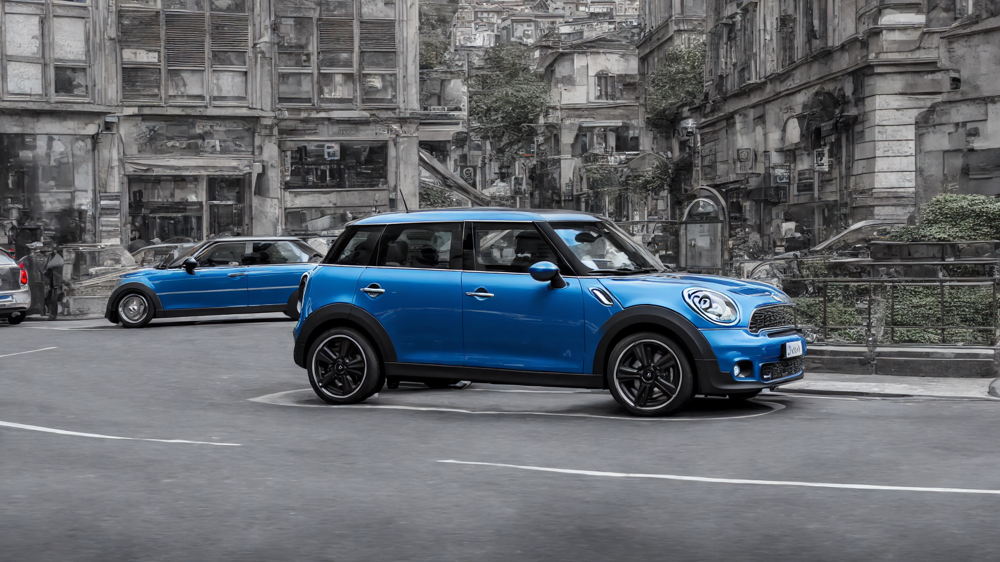

In [104]:
image_controlNet2

In [39]:
# Instruct-Pix2Pix with the new prompt 

In [40]:
InstructPix2piximagesNP = IP2P_pipe(new_prompt, image=image).images[0]

  0%|          | 0/100 [00:00<?, ?it/s]

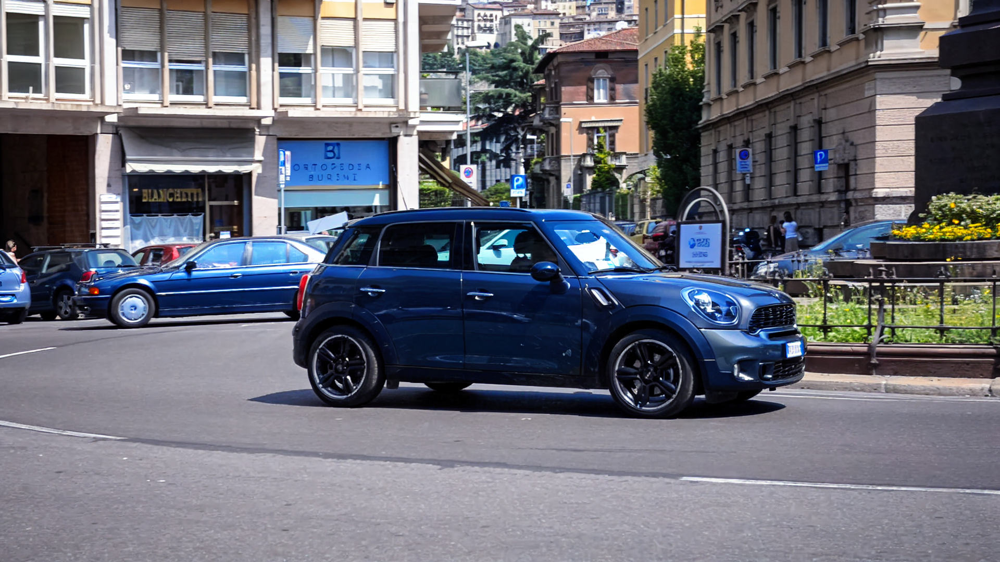

In [41]:
InstructPix2piximagesNP

In [42]:
# Video using InstructPix2Pix (no temporal consistency)

In [16]:
def generate_video(image_folder, video_name, pipe, prompt, mode='IP2P', rotate=True):
    '''
    A simple function to generate video from images 
    Perform image generation using provided pipeline
    '''

    images = list(sorted( [img for img in os.listdir(image_folder) if img.endswith(".jpg") or
             img.endswith(".jpeg") or img.endswith("png")] ) )
    fourcc = cv2.VideoWriter_fourcc(*'MP4V')
    frame = cv2.imread(os.path.join(image_folder, images[0]))
    height, width, layers = frame.shape
    video = cv2.VideoWriter(video_name, fourcc, 50, (width, height))
    print(images)
    for image in images:
        image = cv2.imread(os.path.join(image_folder, image))
        if mode=='CN':
          image_np = np.array(image)
          low_threshold = 100
          high_threshold = 200
          canny_image_np = cv2.Canny(image_np, low_threshold, high_threshold)
          image_cn = canny_image_np[:, :, None]
          image_cn = np.concatenate([image_cn, image_cn, image_cn], axis=2)
          image_cn = Image.fromarray(image_cn)
          new_image = pipe(prompt, num_inference_steps=40, image=image_cn).images[0]
        else:
          image = Image.fromarray( np.array(image).astype(np.uint8)  ).convert("RGB")
          new_image = pipe(prompt, image=image, num_inference_steps=20).images[0]
        
        if rotate:
            video.write(np.array(new_image)[:, :, ::-1])
        else:
            video.write(np.array(new_image))
    cv2.destroyAllWindows()
    video.release()

In [ ]:
generate_video('/content/drive/MyDrive/Data/car-roundabout/', 'video.mp4', IP2P_pipe, new_prompt)

['00000.jpg', '00001.jpg', '00002.jpg', '00003.jpg', '00004.jpg', '00005.jpg', '00006.jpg', '00007.jpg', '00008.jpg', '00009.jpg', '00010.jpg', '00011.jpg', '00012.jpg', '00013.jpg', '00014.jpg', '00015.jpg', '00016.jpg', '00017.jpg', '00018.jpg', '00019.jpg', '00020.jpg', '00021.jpg', '00022.jpg', '00023.jpg', '00024.jpg', '00025.jpg', '00026.jpg', '00027.jpg', '00028.jpg', '00029.jpg', '00030.jpg', '00031.jpg', '00032.jpg', '00033.jpg', '00034.jpg', '00035.jpg', '00036.jpg', '00037.jpg', '00038.jpg', '00039.jpg', '00040.jpg', '00041.jpg', '00042.jpg', '00043.jpg', '00044.jpg', '00045.jpg', '00046.jpg', '00047.jpg', '00048.jpg', '00049.jpg', '00050.jpg', '00051.jpg', '00052.jpg', '00053.jpg', '00054.jpg', '00055.jpg', '00056.jpg', '00057.jpg', '00058.jpg', '00059.jpg', '00060.jpg', '00061.jpg', '00062.jpg', '00063.jpg', '00064.jpg', '00065.jpg', '00066.jpg', '00067.jpg', '00068.jpg', '00069.jpg', '00070.jpg', '00071.jpg', '00072.jpg', '00073.jpg', '00074.jpg']


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

In [ ]:
# SD + ControlNet Video

In [20]:
generate_video('/content/drive/MyDrive/Data/car-roundabout/', 'video2.mp4', CN_pipe, new_prompt, "CN", True)

['00000.jpg', '00001.jpg', '00002.jpg', '00003.jpg', '00004.jpg', '00005.jpg', '00006.jpg', '00007.jpg', '00008.jpg', '00009.jpg', '00010.jpg', '00011.jpg', '00012.jpg', '00013.jpg', '00014.jpg', '00015.jpg', '00016.jpg', '00017.jpg', '00018.jpg', '00019.jpg', '00020.jpg', '00021.jpg', '00022.jpg', '00023.jpg', '00024.jpg', '00025.jpg', '00026.jpg', '00027.jpg', '00028.jpg', '00029.jpg', '00030.jpg', '00031.jpg', '00032.jpg', '00033.jpg', '00034.jpg', '00035.jpg', '00036.jpg', '00037.jpg', '00038.jpg', '00039.jpg', '00040.jpg', '00041.jpg', '00042.jpg', '00043.jpg', '00044.jpg', '00045.jpg', '00046.jpg', '00047.jpg', '00048.jpg', '00049.jpg', '00050.jpg', '00051.jpg', '00052.jpg', '00053.jpg', '00054.jpg', '00055.jpg', '00056.jpg', '00057.jpg', '00058.jpg', '00059.jpg', '00060.jpg', '00061.jpg', '00062.jpg', '00063.jpg', '00064.jpg', '00065.jpg', '00066.jpg', '00067.jpg', '00068.jpg', '00069.jpg', '00070.jpg', '00071.jpg', '00072.jpg', '00073.jpg', '00074.jpg']


  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

In [23]:
!ls

drive  sample_data


In [24]:
!mv video2.mp4 /content/drive/MyDrive/Data/

mv: cannot stat 'video2.mp4': No such file or directory


In [112]:
# Segments 

In [46]:
CHECKPOINT_PATH = '/content/drive/MyDrive/Data/sam_vit_h_4b8939.pth'

In [47]:
MODEL_TYPE = "vit_h"
sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH)
sam.to(device='cuda')

Sam(
  (image_encoder): ImageEncoderViT(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 1280, kernel_size=(16, 16), stride=(16, 16))
    )
    (blocks): ModuleList(
      (0-31): 32 x Block(
        (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=1280, out_features=3840, bias=True)
          (proj): Linear(in_features=1280, out_features=1280, bias=True)
        )
        (norm2): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (mlp): MLPBlock(
          (lin1): Linear(in_features=1280, out_features=5120, bias=True)
          (lin2): Linear(in_features=5120, out_features=1280, bias=True)
          (act): GELU(approximate='none')
        )
      )
    )
    (neck): Sequential(
      (0): Conv2d(1280, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (1): LayerNorm2d()
      (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (3): LayerNorm2d

In [ ]:
mask_generator = SamAutomaticMaskGenerator(sam)

In [ ]:
image_bgr = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

In [50]:
result = mask_generator.generate(image_rgb)

In [51]:
mask_annotator = sv.MaskAnnotator()
detections = sv.Detections.from_sam(result)
annotated_image = mask_annotator.annotate(image_bgr, detections)

In [52]:
segmented_image = Image.fromarray(annotated_image)

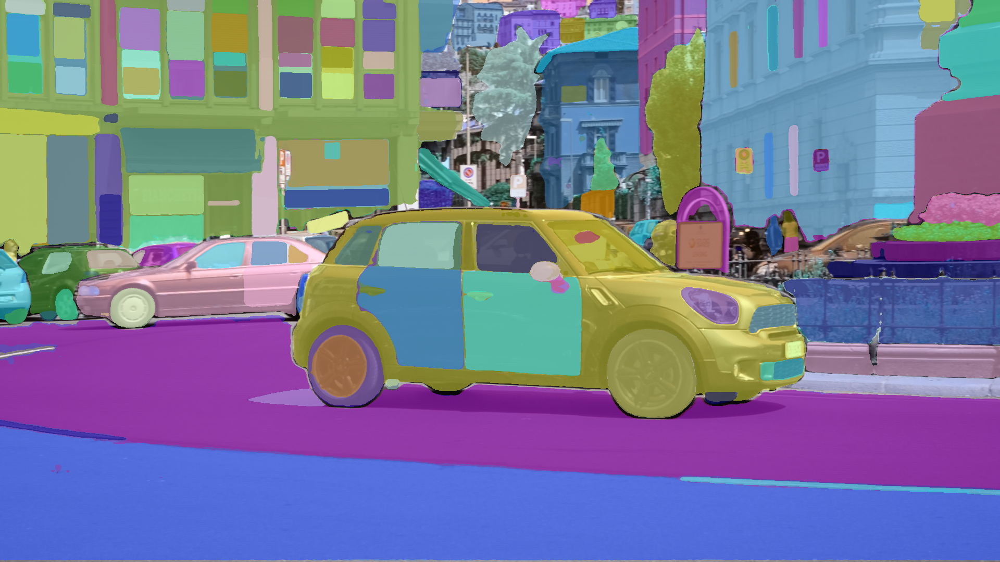

In [53]:
segmented_image

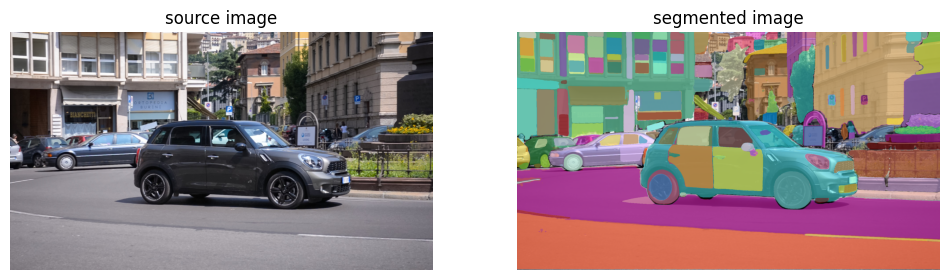

In [54]:
mask_annotator = sv.MaskAnnotator()

detections = sv.Detections.from_sam(sam_result=result)

annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[image_bgr, annotated_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

In [55]:
masks = [ mask['segmentation'] for mask in sorted(result, key=lambda x: x['area'], reverse=True) ]

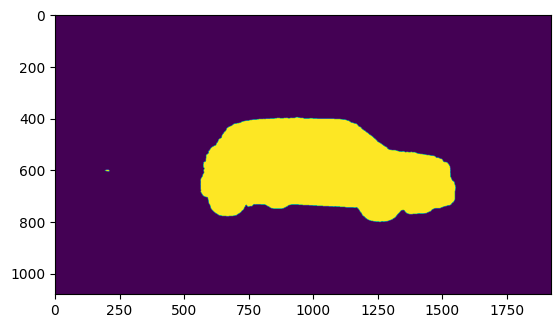

In [56]:
plt.imshow(masks[6])

In [57]:
print(masks[6])

[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]


In [58]:
# Simple in-painting using Stable diffusion 

In [59]:
mask_car = np.where(np.expand_dims(masks[6], 2), [255, 255, 255], [0,0,0] ) 

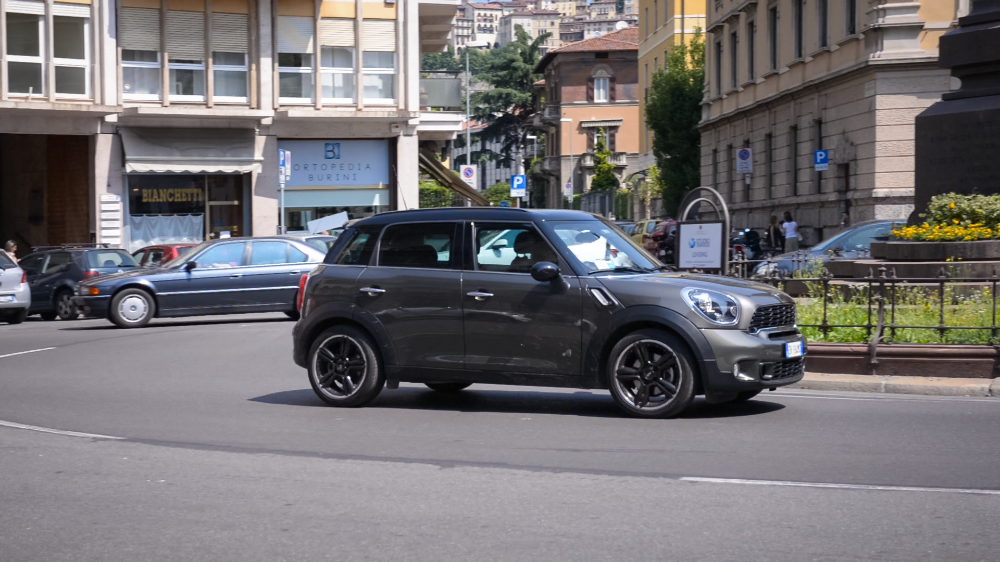

In [60]:
image

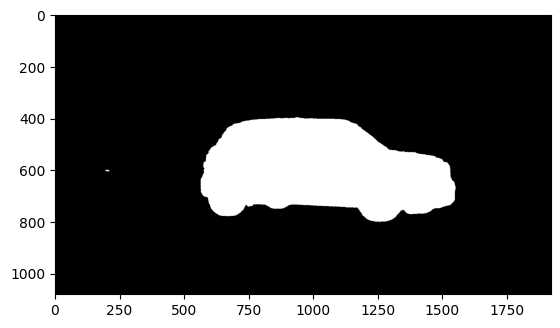

In [61]:
plt.imshow(mask_car)

In [62]:
mask_car = Image.fromarray( np.array(mask_car).astype(np.uint8)  ).convert("RGB").resize( (512,512) )

In [63]:
image_512 = image.resize( (512, 512) )

In [64]:
sd_pipe = StableDiffusionInpaintPipeline.from_pretrained("runwayml/stable-diffusion-inpainting", torch_dtype=torch.float16).to("cuda")
sd_pipe.enable_attention_slicing()

unet/diffusion_pytorch_model.safetensors not found


Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


In [65]:
'''
new_prompt = 'arafed blue mini cooper driving down a city street in the daytime, trending on pexels, italy, clean horizon, inspired by Ai-Mitsu, high contrast hyperrealism 8k, iso 125, stealthy, townscape, woman with black hair, toxic air, crosswalk, exhaust smoke, by Jacopo Bellini, niea 7'
'''

"\nnew_prompt = 'arafed blue mini cooper driving down a city street in the daytime, trending on pexels, italy, clean horizon, inspired by Ai-Mitsu, high contrast hyperrealism 8k, iso 125, stealthy, townscape, woman with black hair, toxic air, crosswalk, exhaust smoke, by Jacopo Bellini, niea 7'\n"

In [66]:
sd_inp_image = sd_pipe(prompt=new_prompt, image=image_512, mask_image=mask_car).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

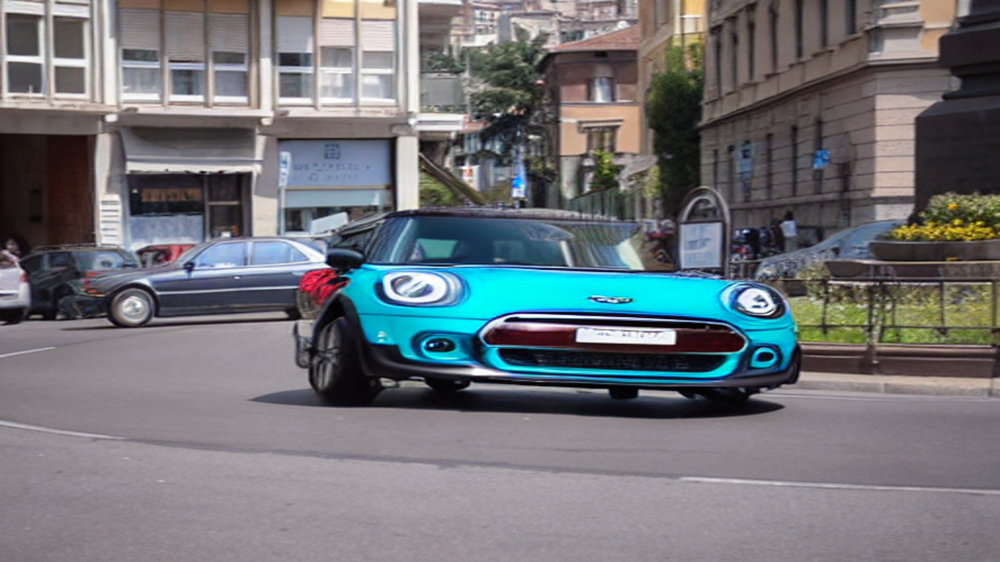

In [67]:
sd_inp_image.resize( (1920, 1080) )

In [68]:
! git clone https://github.com/mikonvergence/ControlNetInpaint
import sys
sys.path.append('./ControlNetInpaint/')

Cloning into 'ControlNetInpaint'...
remote: Enumerating objects: 79, done.
remote: Counting objects: 100% (79/79), done.
remote: Compressing objects: 100% (65/65), done.
remote: Total 79 (delta 29), reused 51 (delta 13), pack-reused 0
Unpacking objects: 100% (79/79), 15.05 MiB | 14.32 MiB/s, done.


In [69]:
from diffusers import StableDiffusionInpaintPipeline, ControlNetModel, UniPCMultistepScheduler
from src.pipeline_stable_diffusion_controlnet_inpaint import *

In [70]:
controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-canny", torch_dtype=torch.float16)
pipeCN_inp = StableDiffusionControlNetInpaintPipeline.from_pretrained(
     "runwayml/stable-diffusion-inpainting", controlnet=controlnet, torch_dtype=torch.float16
 )

# speed up diffusion process with faster scheduler and memory optimization
pipeCN_inp.scheduler = UniPCMultistepScheduler.from_config(pipeCN_inp.scheduler.config)

pipeCN_inp.to('cuda')

# generate image
generator = torch.manual_seed(555)


new_image = pipeCN_inp(
    new_prompt,
    num_inference_steps=50,
    generator=generator,
    image=image_512,
    control_image=image_cn.resize( (512, 512) ),
    mask_image=mask_car).images[0]

unet/diffusion_pytorch_model.safetensors not found
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

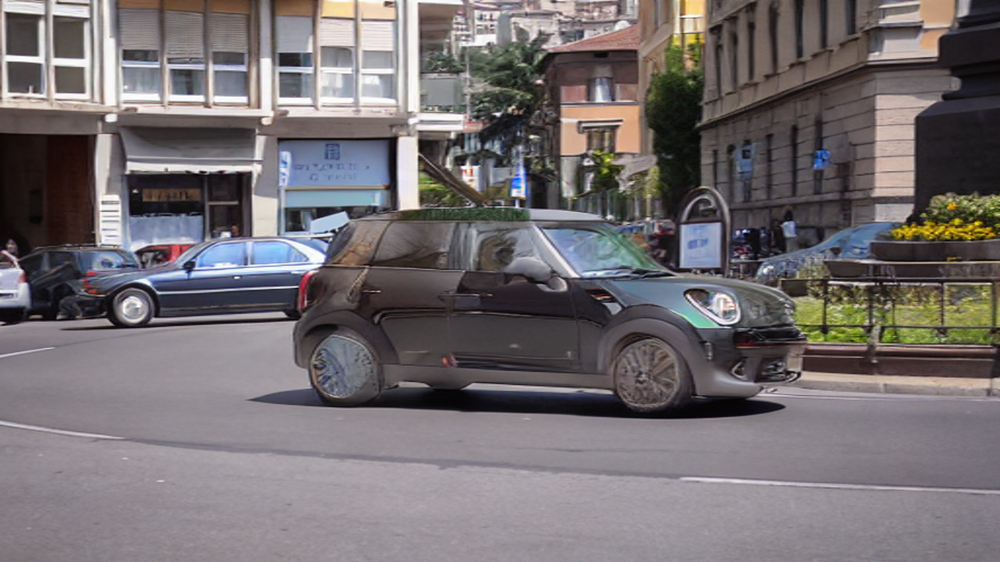

In [71]:
new_image.resize( (1920, 1080) )

In [72]:
# remove car 

In [73]:
new_prompt_remove = 'a city street in the daytime'

In [74]:
new_image_remove = pipeCN_inp(
    new_prompt_remove,
    num_inference_steps=50,
    generator=generator,
    image=image_512,
    control_image=image_cn.resize( (512, 512) ),
    mask_image=mask_car).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

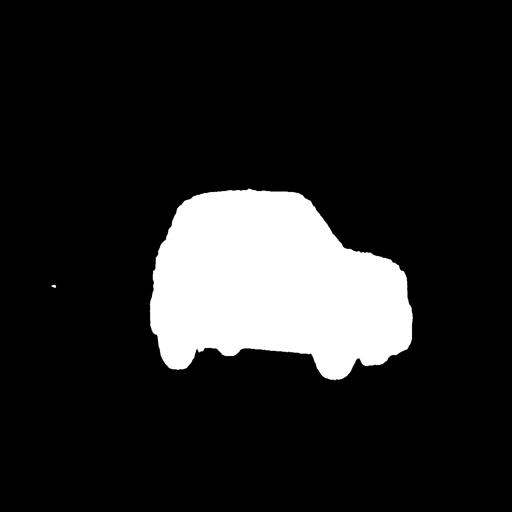

In [75]:
mask_car

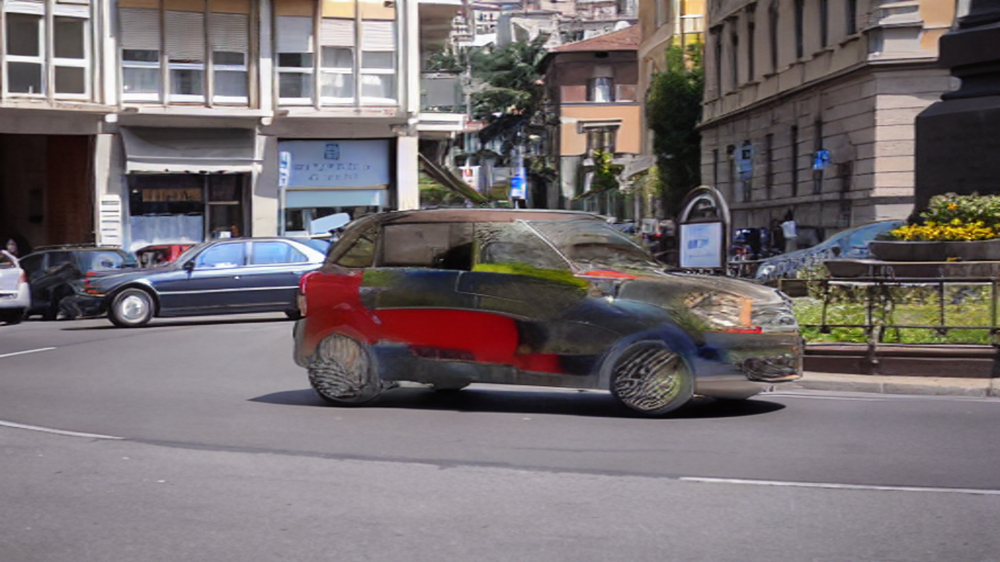

In [76]:
new_image_remove.resize( (1920, 1080) )

In [77]:
sd_inp_image_remove = sd_pipe(image=image_512, mask_image=mask_car, guidance_scale=5.5, prompt="roundabout, concrete, street, no cars, nothing", num_inference_steps=30).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

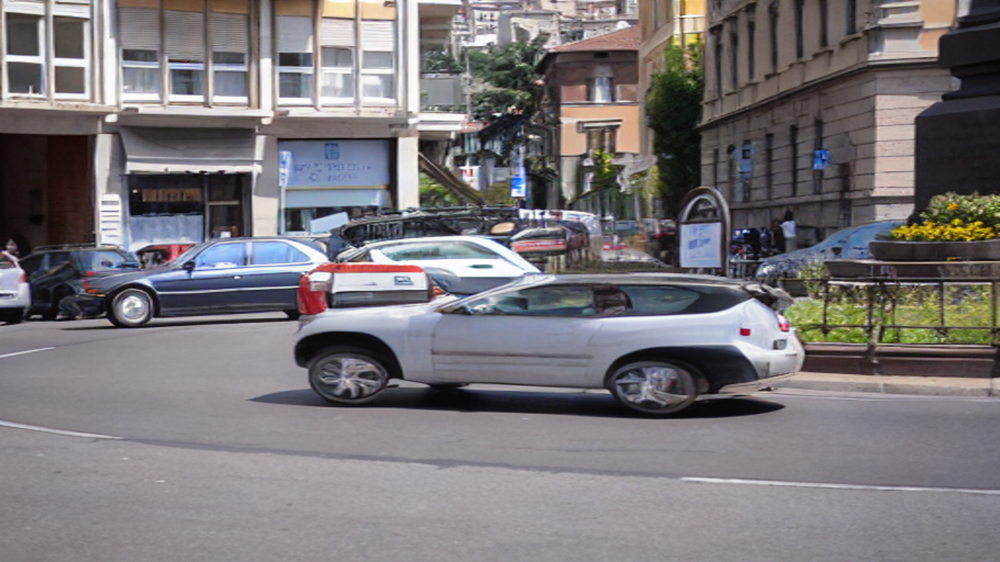

In [78]:
sd_inp_image_remove.resize( (1920, 1080) )

In [79]:
tmp_img_ = np.array(sd_inp_image_remove.resize( (1920, 1080) ) )

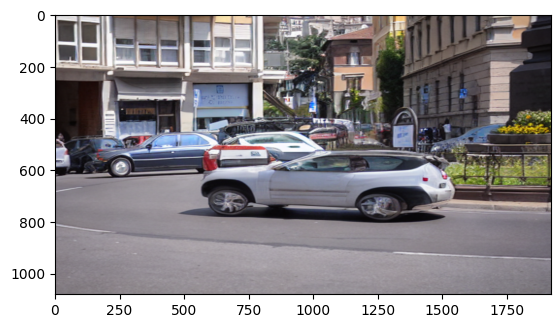

In [80]:
plt.imshow(tmp_img_)

In [82]:
#left_mask = final_mask_tmp[:, :512]
#right_mask = final_mask_tmp[:, frame_tmp[1]-512:]

In [9]:
# Create masks for all video frames 

In [10]:
left_patch = np.ones( (600, 520, 3 ), dtype=np.uint8 ) * 1
center = np.ones( (600, 1000, 3 ), dtype=np.uint8 ) * 255
right_patch = np.ones( (600, 400, 3 ), dtype=np.uint8 ) * 1

In [11]:
top = np.ones( ( int((1080-600)/2), 1920, 3 ), dtype=np.uint8 ) * 1
bottom = np.ones( ( int((1080-600)/2), 1920, 3),  dtype=np.uint8 ) * 1

In [12]:
mask = np.concatenate( (left_patch, center, right_patch), axis=1) 

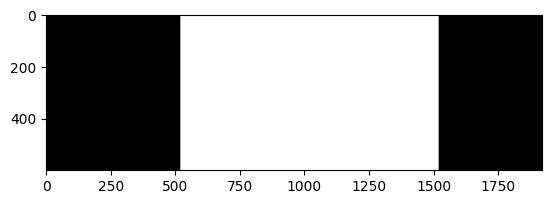

In [13]:
plt.imshow(mask)

In [14]:
mask = np.concatenate( (top, mask, bottom), axis=0) 

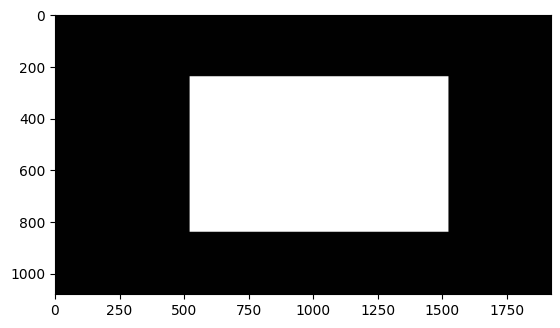

In [15]:
plt.imshow(mask)

In [16]:
mask_img = Image.fromarray(mask, 'RGB')

In [17]:
mask_img.save("/content/drive/MyDrive/Data/mask_tmp.png")

In [91]:
mask_img = mask_img.resize( (512, 512) )

In [98]:
sd_inp_image_remove = sd_pipe(image=image_512, mask_image=mask_img, guidance_scale=7.5, prompt="concrete, street, no cars, nothing", num_inference_steps=30).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

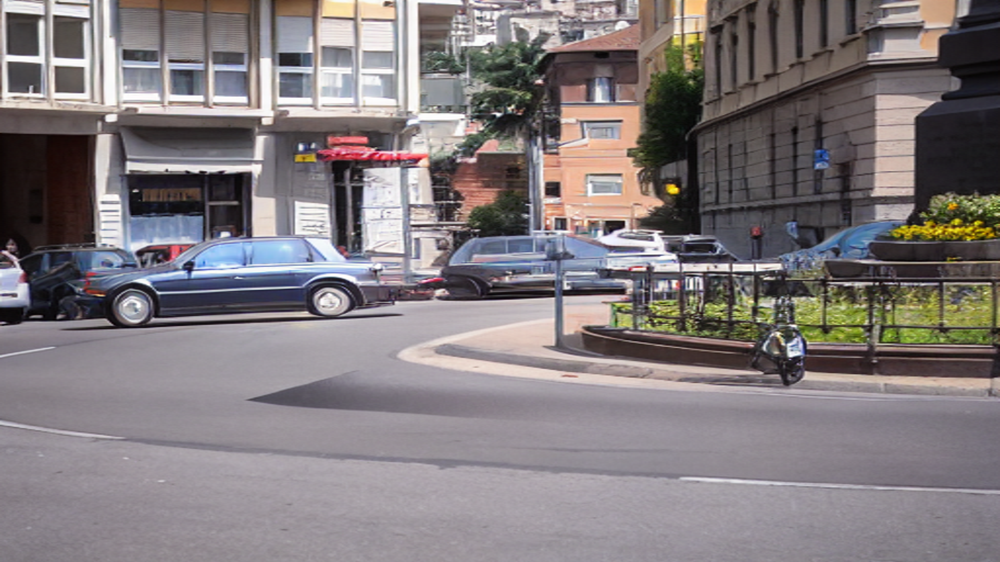

In [99]:
sd_inp_image_remove.resize( (1920, 1080) )

In [8]:
%cd /content/

/content


In [9]:
!ls

drive  sample_data


In [10]:
# FGVC with SD
'''
1. We need masks. One could use object detection model and segmenntation model but as this is just example, 
let's just do a simple mask. In the car case, camera moves with the car so mask can be ~identical for all framee
2. I have modified FGVC to use runway diffusion model for in-painting 
(Original github - https://github.com/vt-vl-lab/FGVC )
'''

"\n1. We need masks. One could use object detection model and segmenntation model but as this is just example, \nlet's just do a simple mask. In the car case, camera moves with the car so mask can be ~identical for all framee\n2. I have modified FGVC to use runway diffusion model for in-painting \n(Original github - https://github.com/vt-vl-lab/FGVC )\n"

In [11]:
# Key modifications:

# 1. Added a very simple function to run SD inpainting in spatial inpaint 

'''
def sd_inpaint(pipe, mask, video_comp):
    keyFrameInd = np.argmax(np.sum(np.sum(mask, axis=0), axis=0))
    prompt = "high quality dslr photo, street, sidewalk, city"
    mask_tmp = mask[:, :, keyFrameInd]
    final_mask_tmp = np.where(np.expand_dims(mask_tmp, 2), [255, 255, 255], [0,0,0] ) 
    frame_tmp = video_comp[:, :, :, keyFrameInd] * 255.
    frame_tmp = np.array(frame_tmp).astype(np.uint8)
    final_mask = Image.fromarray( np.array(final_mask_tmp).astype(np.uint8)  ).convert("RGB").resize( (512,512) )
    final_frame = Image.fromarray( np.array(frame_tmp).astype(np.uint8)  ).convert("RGB").resize( (512,512) )
    inpt = pipe(prompt=prompt, image=final_frame, mask_image=final_mask).images[0]
    inpt = inpt.resize( (1920, 1080) )
    inpt = np.array(inpt)
    video_comp[mask[:,:, keyFrameInd], :, keyFrameInd] = inpt[mask[:, :, keyFrameInd], :]
    mask[:, :, keyFrameInd] = False
    return mask, video_comp
'''

# 2. commented out deepfill and called sd_inpaint in video_completion.py 


'\ndef sd_inpaint(pipe, mask, video_comp):\n    keyFrameInd = np.argmax(np.sum(np.sum(mask, axis=0), axis=0))\n    prompt = "high quality dslr photo, street, sidewalk, city"\n    mask_tmp = mask[:, :, keyFrameInd]\n    final_mask_tmp = np.where(np.expand_dims(mask_tmp, 2), [255, 255, 255], [0,0,0] ) \n    frame_tmp = video_comp[:, :, :, keyFrameInd] * 255.\n    frame_tmp = np.array(frame_tmp).astype(np.uint8)\n    final_mask = Image.fromarray( np.array(final_mask_tmp).astype(np.uint8)  ).convert("RGB").resize( (512,512) )\n    final_frame = Image.fromarray( np.array(frame_tmp).astype(np.uint8)  ).convert("RGB").resize( (512,512) )\n    inpt = pipe(prompt=prompt, image=final_frame, mask_image=final_mask).images[0]\n    inpt = inpt.resize( (1920, 1080) )\n    inpt = np.array(inpt)\n    video_comp[mask[:,:, keyFrameInd], :, keyFrameInd] = inpt[mask[:, :, keyFrameInd], :]\n    mask[:, :, keyFrameInd] = False\n    return mask, video_comp\n'

In [12]:
! cp -rf /content/drive/MyDrive/Data/FGVC-master .

In [13]:
!ls

drive  FGVC-master  sample_data


In [14]:
%cd /content/FGVC-master/tool

/content/FGVC-master/tool


In [15]:
!ls

frame_inpaint.py	get_flowNN.py	    video_completion.py
get_flowNN_gradient.py	spatial_inpaint.py


In [16]:
!ls ../data/

car-roundabout	car-roundabout_mask  tennis  tennis_mask


In [17]:
! which python3

/usr/bin/python3


In [18]:
!ps

    PID TTY          TIME CMD
      1 ?        00:00:00 docker-init
      7 ?        00:00:03 node
     11 ?        00:00:00 oom_monitor.sh
     13 ?        00:00:00 run.sh
     14 ?        00:00:00 kernel_manager_
     38 ?        00:00:00 tail
     71 ?        00:00:06 python3 <defunct>
     72 ?        00:00:00 colab-fileshim.
    117 ?        00:00:03 jupyter-noteboo
    118 ?        00:00:00 dap_multiplexer
   2585 ?        00:00:13 python3
   2630 ?        00:00:00 python3
   2832 ?        00:00:00 bash
   2833 ?        00:00:00 drive
   2834 ?        00:00:00 grep
   2940 ?        00:00:02 drive
   3031 ?        00:00:00 bash
   3032 ?        00:00:00 directoryprefet
   3033 ?        00:00:00 tail
   3034 ?        00:00:00 python3
   3371 ?        00:00:00 language_servic
   3382 ?        00:00:29 node
   4381 ?        00:00:00 sleep
   4388 ?        00:00:00 ps


In [ ]:
'''
 PID TTY          TIME CMD
      1 ?        00:00:00 docker-init
      7 ?        00:00:03 node
     11 ?        00:00:00 oom_monitor.sh
     13 ?        00:00:00 run.sh
     14 ?        00:00:00 kernel_manager_
     38 ?        00:00:00 tail
     71 ?        00:00:06 python3 <defunct>
     72 ?        00:00:00 colab-fileshim.
    117 ?        00:00:03 jupyter-noteboo
    118 ?        00:00:00 dap_multiplexer
   2585 ?        00:00:13 python3
   2630 ?        00:00:00 python3
   2832 ?        00:00:00 bash
   2833 ?        00:00:00 drive
   2834 ?        00:00:00 grep
   2940 ?        00:00:02 drive
   3031 ?        00:00:00 bash
   3032 ?        00:00:00 directoryprefet
   3033 ?        00:00:00 tail
   3034 ?        00:00:00 python3
   3371 ?        00:00:00 language_servic
   3382 ?        00:00:29 node
   4381 ?        00:00:00 sleep
   4388 ?        00:00:00 ps
'''

In [19]:
!nohup /usr/bin/python3 -u video_completion.py --mode object_removal --path /content/FGVC-master/data/car-roundabout --path_mask /content/FGVC-master/data/car-roundabout_mask --outroot /content/drive/MyDrive/Data/Out-FGVC-SD/ --seamless &

nohup: appending output to 'nohup.out'


In [59]:
!ps

    PID TTY          TIME CMD
      1 ?        00:00:00 docker-init
      7 ?        00:00:06 node
     11 ?        00:00:03 oom_monitor.sh
     13 ?        00:00:00 run.sh
     14 ?        00:00:02 kernel_manager_
     38 ?        00:00:00 tail
     71 ?        00:00:06 python3 <defunct>
     72 ?        00:00:00 colab-fileshim.
    117 ?        00:00:07 jupyter-noteboo
    118 ?        00:00:06 dap_multiplexer
   2585 ?        00:00:39 python3
   2630 ?        00:00:15 python3
   2832 ?        00:00:00 bash
   2833 ?        00:00:00 drive
   2834 ?        00:00:00 grep
   2940 ?        00:00:31 drive
   3031 ?        00:00:00 bash
   3032 ?        00:00:00 directoryprefet
   3033 ?        00:00:00 tail
   3034 ?        00:00:00 python3
   4564 ?        18:50:45 python3
  32145 ?        00:00:00 language_servic
  32153 ?        00:00:43 node
  32511 ?        00:00:00 sleep
  32512 ?        00:00:00 ps


In [ ]:
'''
4564 ?        00:00:04 python3
'''

In [156]:
nho = "/content/FGVC-master/tool/nohup.out"
file1 = open(nho, "r")

In [157]:
for el in file1:
  print(el)

2023-05-24 03:31:54.155822: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT

Calculating forward flow  0 <--->  1 

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)

  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]

Calculating forward flow  1 <--->  2 

Calculating forward flow  2 <--->  3 

Calculating forward flow  3 <--->  4 

Calculating forward flow  4 <--->  5 

Calculating forward flow  5 <--->  6 

Calculating forward flow  6 <--->  7 

Calculating forward flow  7 <--->  8 

Calculating forward flow  8 <--->  9 

Calculating forward flow  9 <---> 10 

Calculating forward flow 10 <---> 11 

Calculating forward flow 11 <---> 12 

Calculating forward flow 12 <---> 13 

Calculating forward flow 13 <---> 14 

Calculating for

In [155]:
!ls -ltrh

total 120K
-rw------- 1 root root 4.2K May 24 03:30 frame_inpaint.py
-rw------- 1 root root  26K May 24 03:30 get_flowNN_gradient.py
-rw------- 1 root root  37K May 24 03:30 video_completion.py
-rw------- 1 root root  23K May 24 03:30 get_flowNN.py
-rw------- 1 root root 1.5K May 24 03:30 spatial_inpaint.py
drwxr-xr-x 2 root root 4.0K May 24 03:31 __pycache__
-rw------- 1 root root 9.8K May 24 08:39 nohup.out


In [114]:
#! rm -rf nohup.out

In [144]:
%%shell
sudo apt install htop

Reading package lists... Done
Building dependency tree       
Reading state information... Done
Suggested packages:
  strace
The following NEW packages will be installed:
  htop
0 upgraded, 1 newly installed, 0 to remove and 24 not upgraded.
Need to get 80.5 kB of archives.
After this operation, 225 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal/main amd64 htop amd64 2.2.0-2build1 [80.5 kB]
Fetched 80.5 kB in 0s (258 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package htop.
(Reading database ... 122532 files and

In [159]:
! htop > out_htop.txt

In [160]:
fhtop = "/content/FGVC-master/tool/out_htop.txt"
file1 = open(fhtop, "r")

In [161]:
for elem in file1:
  print(elem)

)07=  1  [                          0.0%]   Tasks: 22, 111 thr; 1 running2  [                          0.0%]   Load average: 0.45 0.48 0.63 Mem[|||||||            1.26G/12.7G]   Uptime: 02:08:13Swp[                         0K/0K]

    PID USER      PRI  NI  VIRT   RES   SHR S CPU% MEM%   TIME+  Command          33029 root       20   0  7936  3596  3096 R 200.  0.0  0:00.01 htop           1 root20   0  1044     8     0 S  0.0  0.0  0:00.69 /sbin/docker-in90 root20   0  910M 73372 24188 S  0.0  0.6  0:00.00 /tools/node/bin91 root20   0  910M 73372 24188 S  0.0  0.6  0:00.43 /tools/node/bin92 root20   0  910M 73372 24188 S  0.0  0.6  0:00.36 /tools/node/bin93 root20   0  910M 73372 24188 S  0.0  0.6  0:00.43 /tools/node/bin94 root20   0  910M 73372 24188 S  0.0  0.6  0:00.44 /tools/node/bin95 root20   0  910M 73372 24188 S  0.0  0.6  0:00.00 /tools/node/bin100 root20   0  910M 73372 24188 S  0.0  0.6  0:00.14 /tools/node/bin101 root20   0  910M 73372 24188 S  0.0  0.6  0:00.14 /tools/n